In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.ensemble import IsolationForest

In [ ]:
# Load the data
df = pd.read_csv('/content/drive/MyDrive/Mv/vitals_and_dementia_ratings.csv')

In [ ]:
# Convert Timestamp to datetime
df['Timestamp'] = pd.to_datetime(df['Timestamp'])


In [ ]:
# Check for missing values and handle them
print(df.isnull().sum())
df = df.dropna()  # Drop rows with missing values

Patient ID                  0
Timestamp                   0
SPO2                        0
Blood Pressure Systolic     0
Blood Pressure Diastolic    0
Temperature                 0
Heart Rate                  0
Clinical Dementia Rating    0
dtype: int64


In [ ]:
# Sort the dataframe by Patient ID and Timestamp
df = df.sort_values(['Patient ID', 'Timestamp'])

In [ ]:
# Calculate correlation matrix
corr_matrix = df.corr()

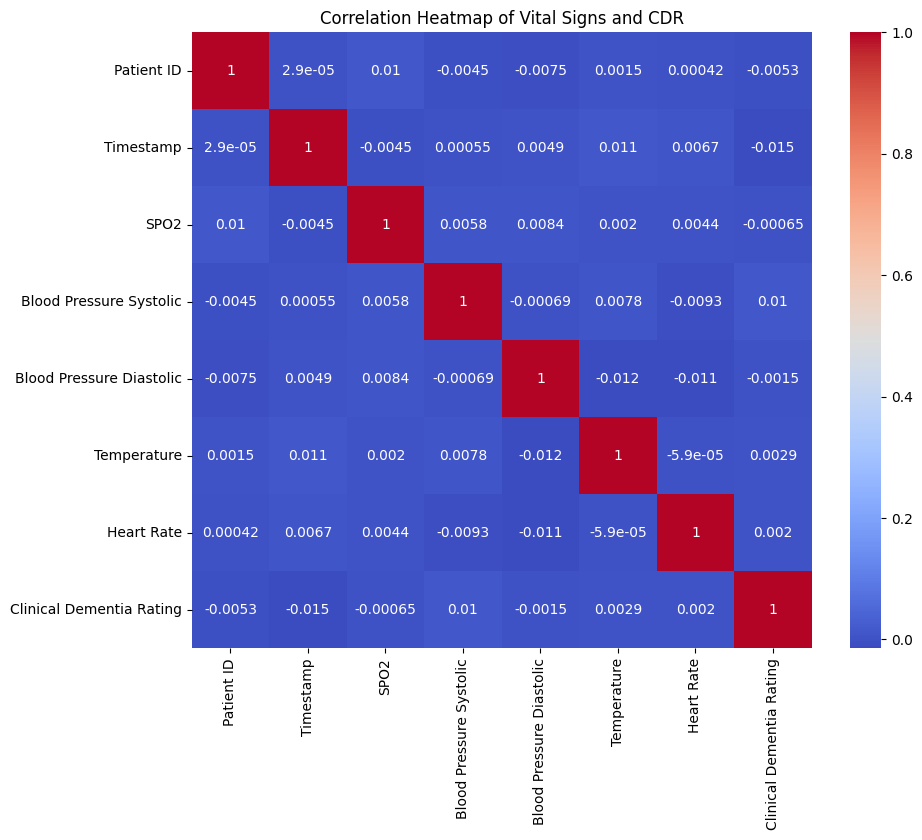

In [ ]:
# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap of Vital Signs and CDR')
plt.show()

In [ ]:
# No need for resampling as we're using minute-wise data
df_minute = df

print(df_minute.head())
print(df_minute.dtypes)
print(df_minute.isnull().sum())
print(df_minute.describe())

    Patient ID           Timestamp  SPO2  Blood Pressure Systolic  \
8            1 2024-05-12 03:44:00  85.1                    112.7   
4            1 2024-05-12 05:13:00  89.6                     97.2   
10           1 2024-05-12 05:36:00  85.6                    166.2   
15           1 2024-05-12 05:52:00  88.7                    132.6   
17           1 2024-05-12 06:17:00  92.2                    115.7   

    Blood Pressure Diastolic  Temperature  Heart Rate  \
8                       83.4         38.6        52.7   
4                      118.4         39.1        84.6   
10                     108.0         37.0        78.3   
15                      93.8         35.8       132.7   
17                      73.1         37.2       138.2   

    Clinical Dementia Rating  
8                        2.5  
4                        0.6  
10                       2.0  
15                       0.5  
17                       1.8  
Patient ID                           int64
Timestamp    

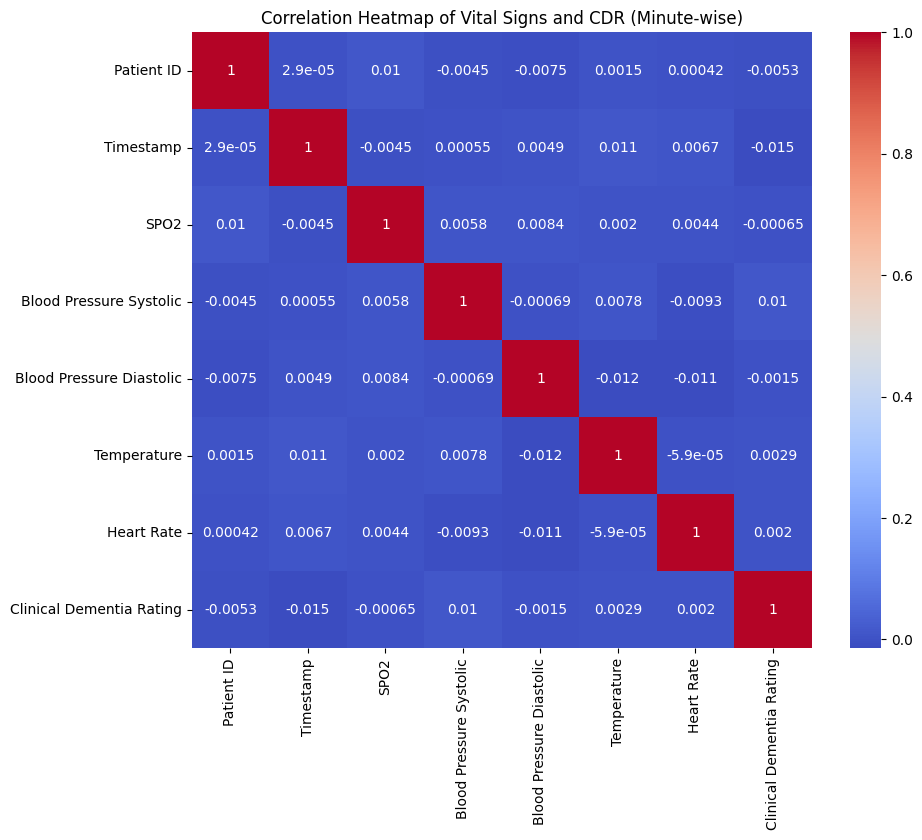

In [ ]:
# Calculate correlation matrix for minute-wise data
corr_matrix_minute = df_minute.corr()

# Plot heatmap for minute-wise data
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix_minute, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap of Vital Signs and CDR (Minute-wise)')
plt.show()

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

def plot_seasonality_trend(data, column, patient_id):
    plt.figure(figsize=(12, 8))

    # Calculate the period based on available data
    total_minutes = len(data)
    period = min(1440, total_minutes // 2)  # Use 1 day or half of available data, whichever is smaller

    # Perform seasonal decomposition
    try:
        result = seasonal_decompose(data[column], model='additive', period=period)

        # Plot original data
        plt.subplot(411)
        plt.plot(data['Timestamp'], data[column])
        plt.title(f'Seasonality and Trend Analysis for Patient {patient_id} - {column}')
        plt.ylabel('Original')

        # Plot trend
        plt.subplot(412)
        plt.plot(data['Timestamp'], result.trend)
        plt.ylabel('Trend')

        # Plot seasonal
        plt.subplot(413)
        plt.plot(data['Timestamp'], result.seasonal)
        plt.ylabel('Seasonal')

        # Plot residual
        plt.subplot(414)
        plt.plot(data['Timestamp'], result.resid)
        plt.ylabel('Residual')

    except ValueError as e:
        plt.text(0.5, 0.5, f"Insufficient data for decomposition: {str(e)}",
                 ha='center', va='center', wrap=True)

    plt.tight_layout()
    plt.show()


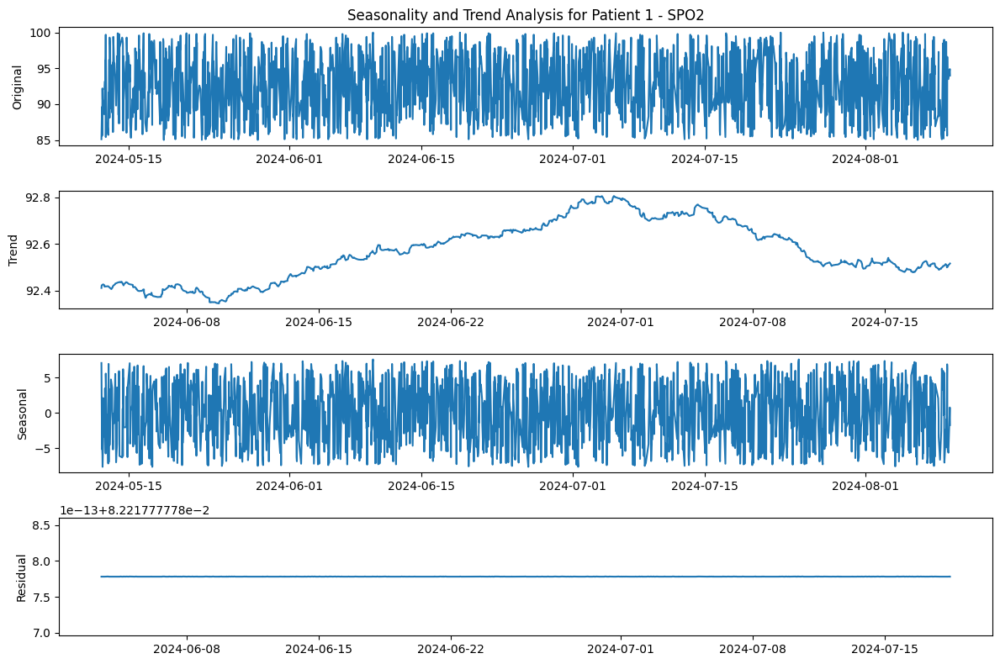

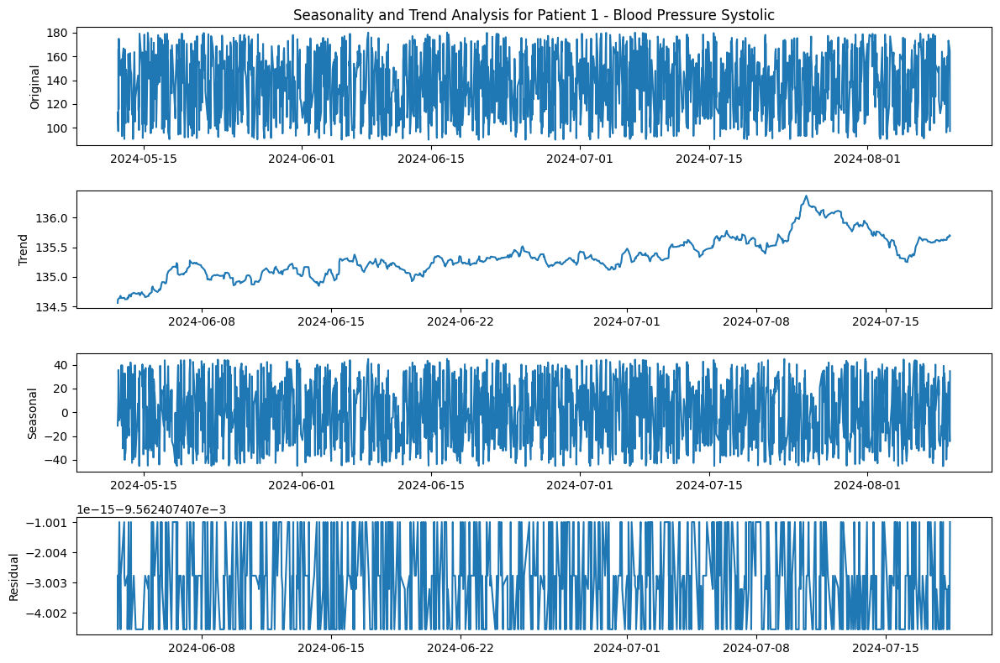

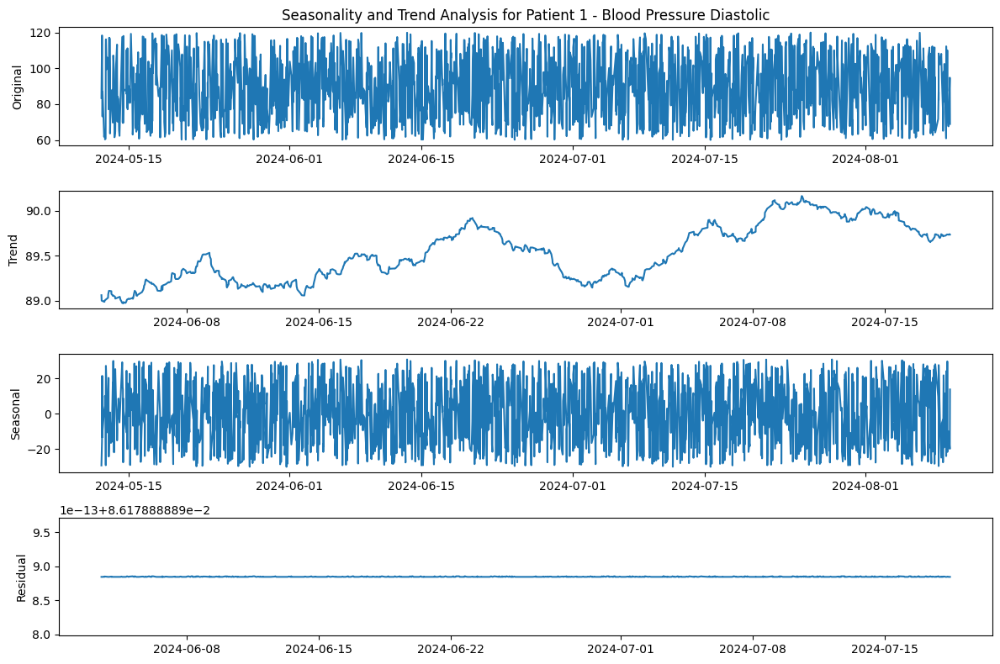

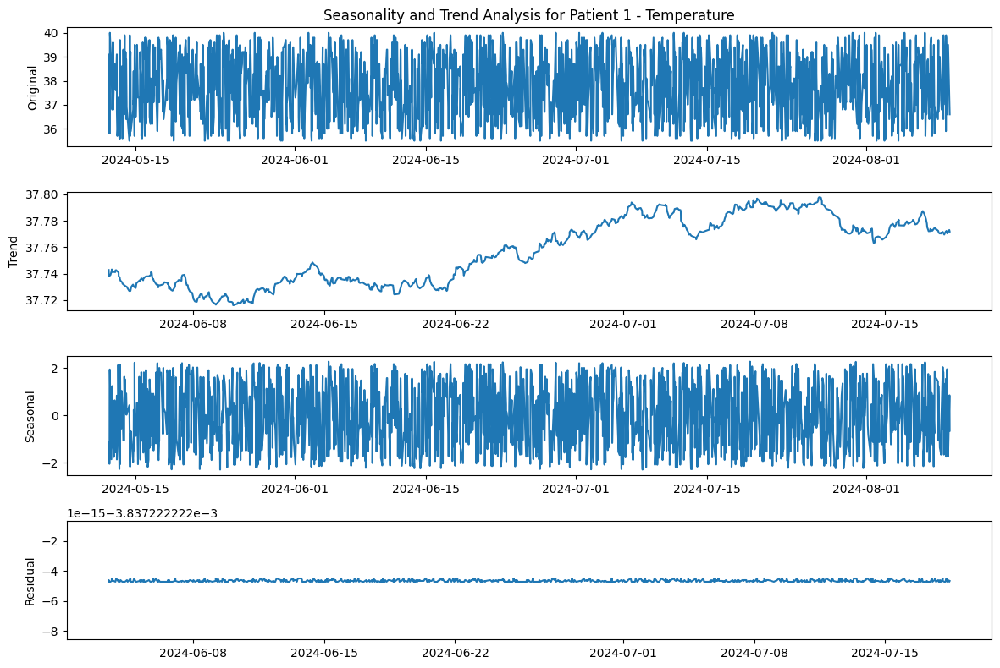

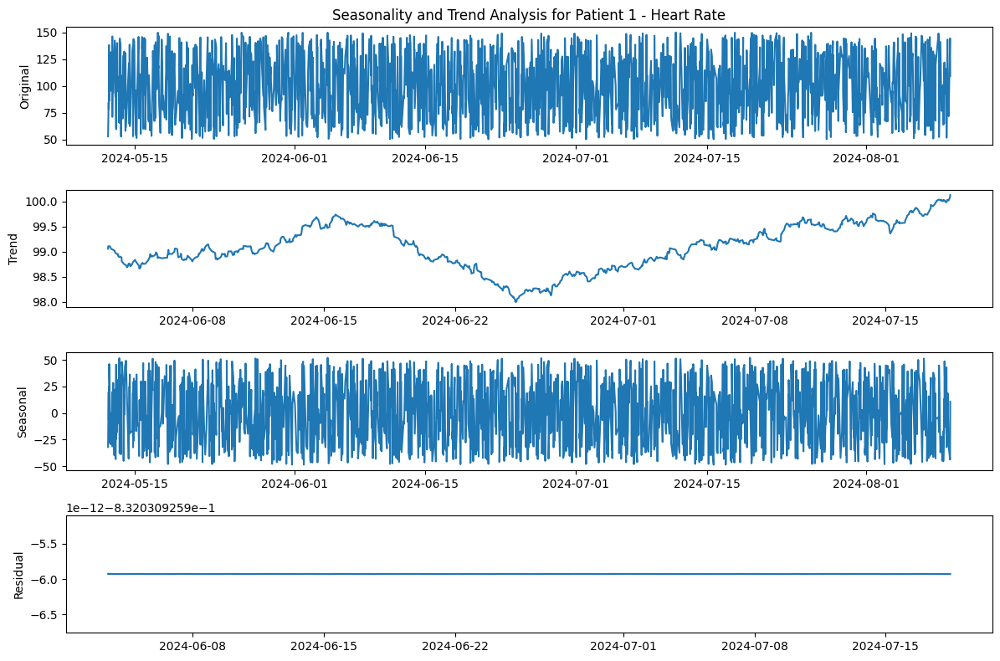

...

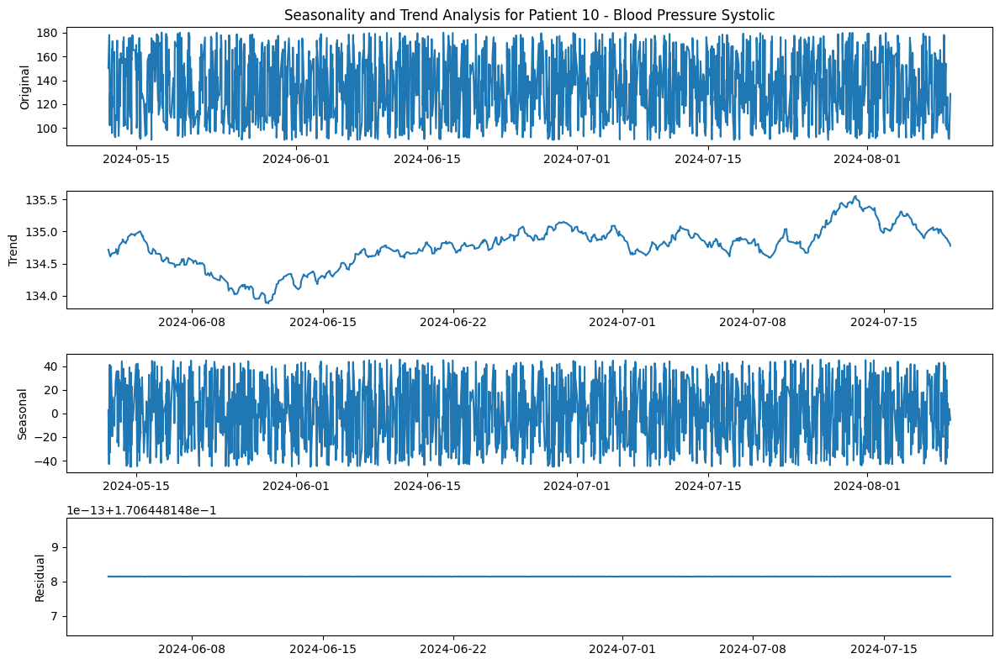

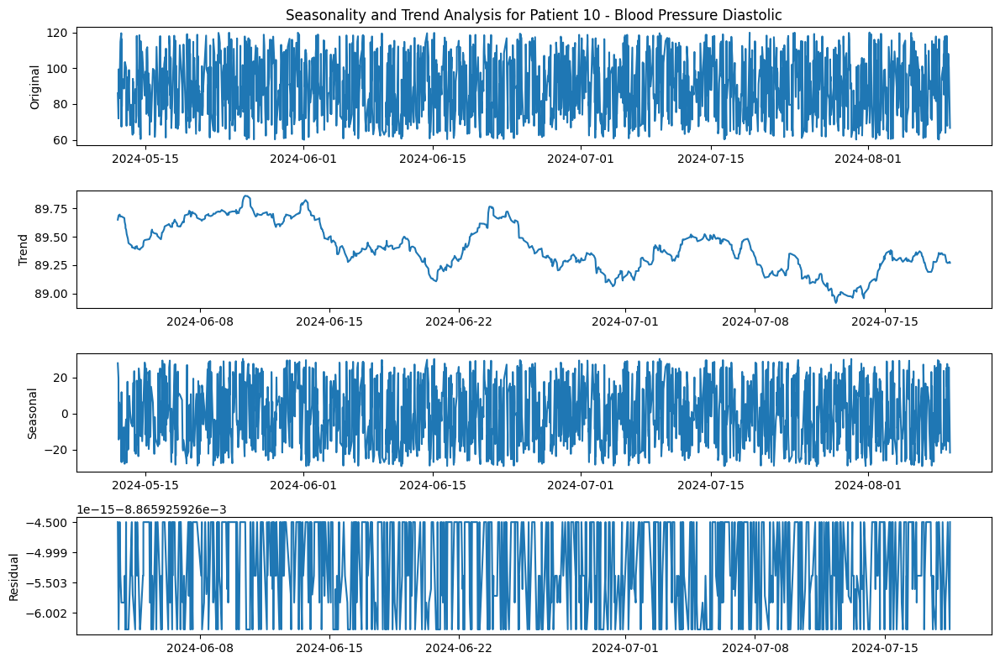

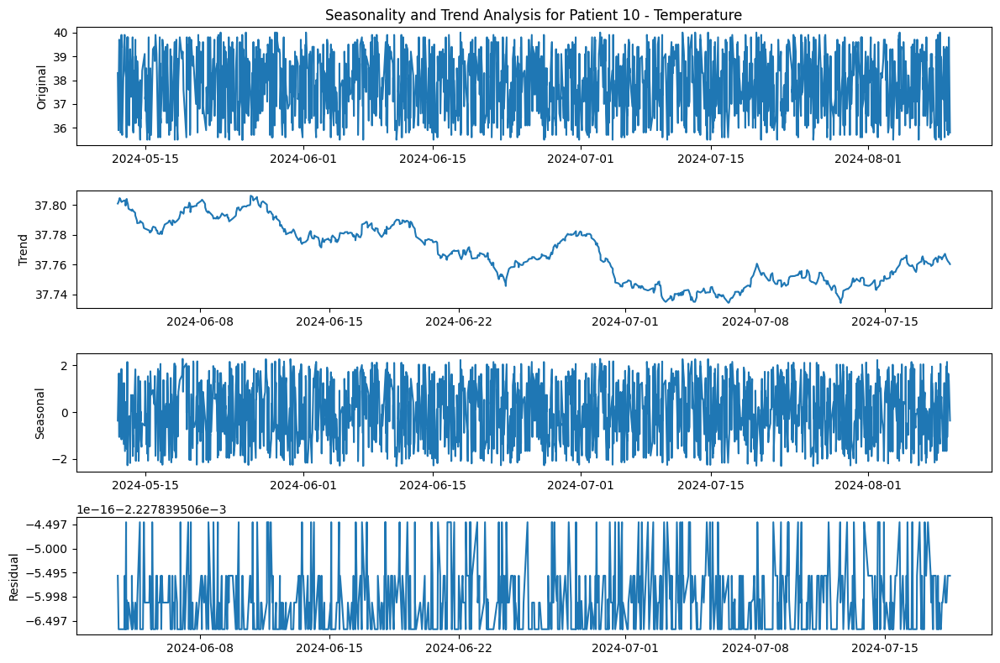

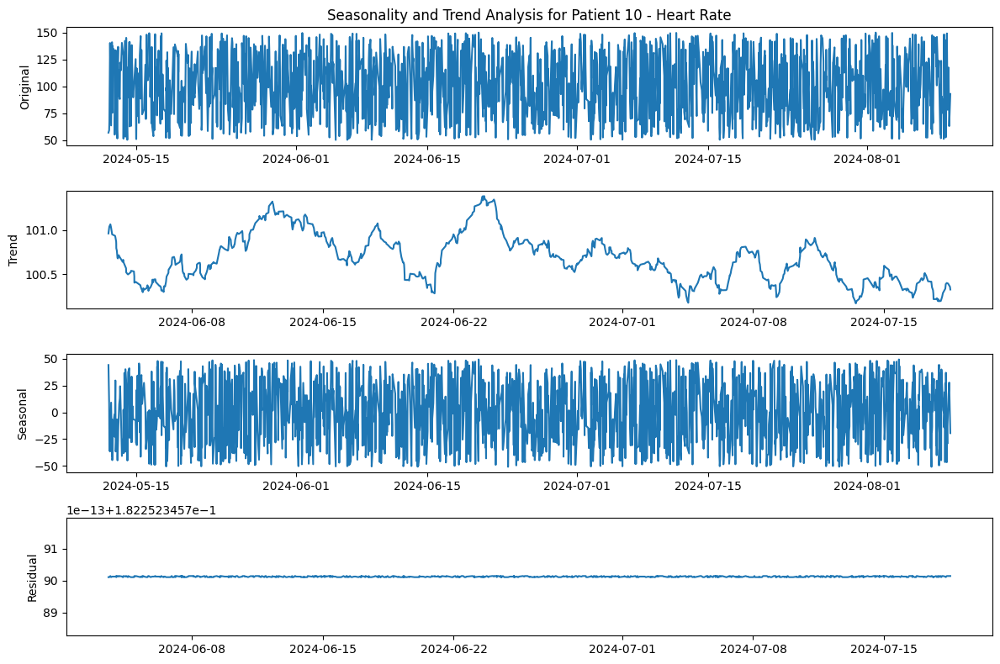

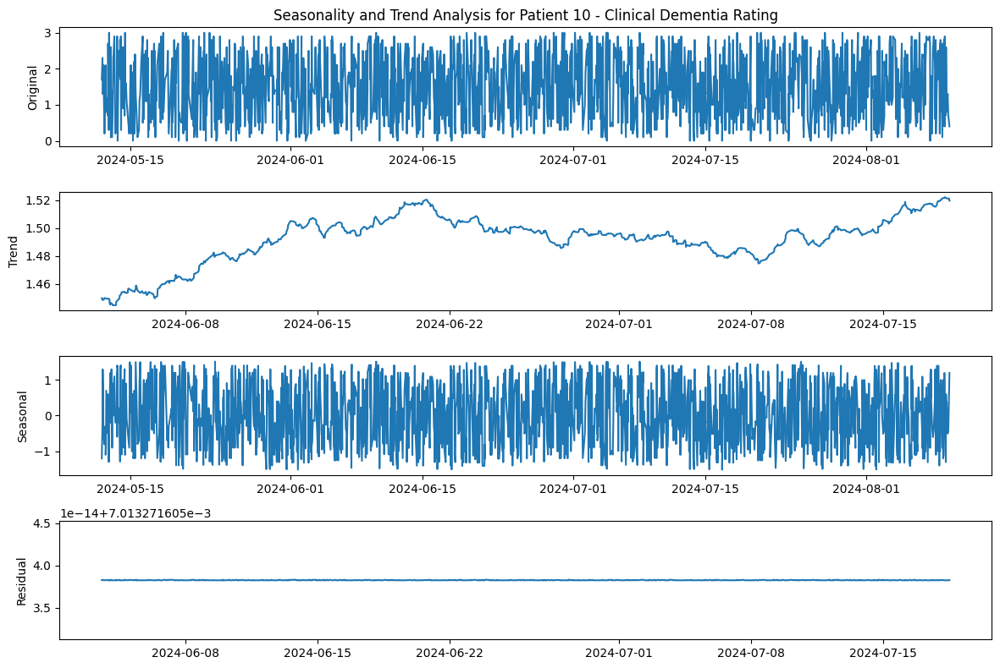

In [ ]:
# Analyze seasonality and trend for each patient and vital sign
vital_signs = ['SPO2', 'Blood Pressure Systolic', 'Blood Pressure Diastolic', 'Temperature', 'Heart Rate', 'Clinical Dementia Rating']

for patient_id, group in df_minute.groupby('Patient ID'):
    for vital in vital_signs:
        plot_seasonality_trend(group, vital, patient_id)

# **LSTM Model:**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, r2_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
from math import sqrt

In [ ]:
def create_sequences(data, target, seq_length):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i:(i + seq_length)])
        y.append(target[i + seq_length])
    return np.array(X), np.array(y)


In [ ]:
def build_lstm_model(patient_data, seq_length=60):  # 60 minutes (1 hour) sequence length
    # Define features and target
    features = ['SPO2', 'Blood Pressure Systolic', 'Blood Pressure Diastolic', 'Temperature', 'Heart Rate']
    target = 'Clinical Dementia Rating'

    # Normalize the data
    scaler_X = MinMaxScaler(feature_range=(0, 1))
    scaler_y = MinMaxScaler(feature_range=(0, 1))

    scaled_features = scaler_X.fit_transform(patient_data[features])
    scaled_target = scaler_y.fit_transform(patient_data[[target]])

    # Create sequences
    X, y = create_sequences(scaled_features, scaled_target, seq_length)

    # Split into train and test sets
    train_size = int(len(X) * 0.8)
    X_train, X_test = X[:train_size], X[train_size:]
    y_train, y_test = y[:train_size], y[train_size:]

    # Build the LSTM model
    model = Sequential([
        LSTM(50, activation='relu', input_shape=(seq_length, len(features))),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2, verbose=0)

    # Make predictions
    train_predict = model.predict(X_train)
    test_predict = model.predict(X_test)

    # Invert predictions to original scale
    train_predict = scaler_y.inverse_transform(train_predict)
    y_train = scaler_y.inverse_transform(y_train)
    test_predict = scaler_y.inverse_transform(test_predict)
    y_test = scaler_y.inverse_transform(y_test)

    # Calculate RMSE and R2 score
    train_rmse = sqrt(mean_squared_error(y_train, train_predict))
    test_rmse = sqrt(mean_squared_error(y_test, test_predict))
    train_r2 = r2_score(y_train, train_predict)
    test_r2 = r2_score(y_test, test_predict)

    print(f'Train RMSE: {train_rmse:.3f}')
    print(f'Test RMSE: {test_rmse:.3f}')
    print(f'Train R2 Score: {train_r2:.3f}')
    print(f'Test R2 Score: {test_r2:.3f}')

    # Plot results
    plt.figure(figsize=(12, 6))
    plt.plot(patient_data.index[seq_length:train_size+seq_length], y_train, label='Train Actual')
    plt.plot(patient_data.index[seq_length:train_size+seq_length], train_predict, label='Train Predict')
    plt.plot(patient_data.index[train_size+seq_length:], y_test, label='Test Actual')
    plt.plot(patient_data.index[train_size+seq_length:], test_predict, label='Test Predict')
    plt.title('LSTM Model: Clinical Dementia Rating Prediction')
    plt.legend()
    plt.show()

    # Plot loss
    plt.figure(figsize=(12, 6))
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()
    plt.show()

    return model, train_rmse, test_rmse, train_r2, test_r2


Building LSTM model for Patient 1


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Train RMSE: 0.874
Test RMSE: 0.905
Train R2 Score: -0.058
Test R2 Score: -0.056


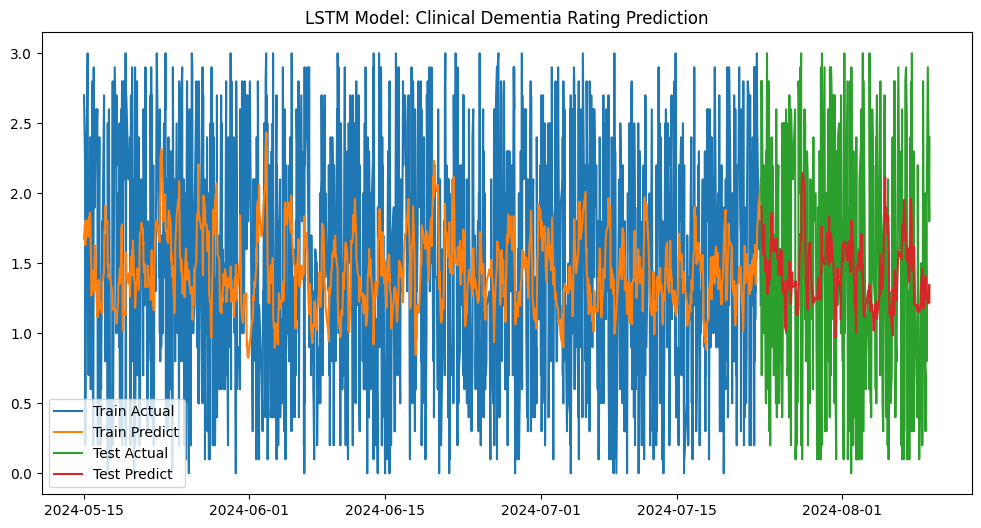

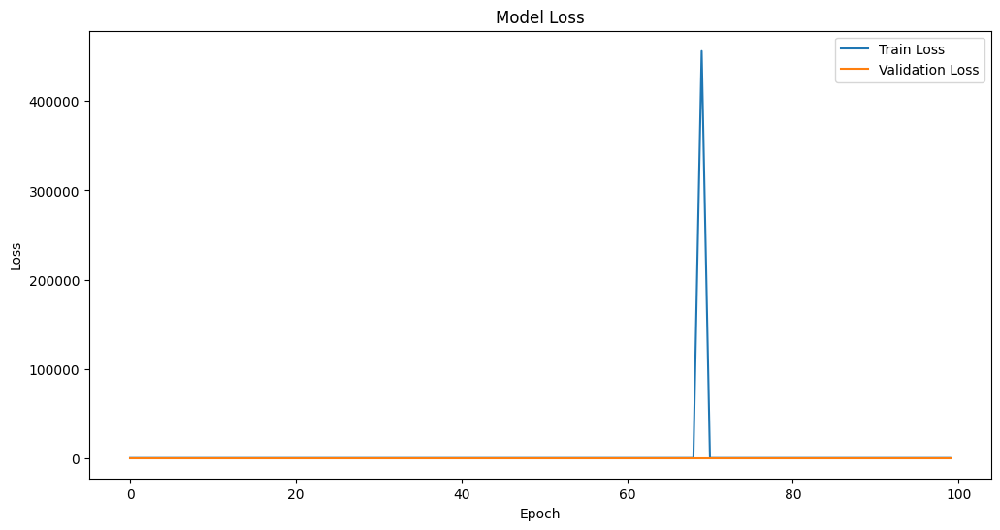


Building LSTM model for Patient 2


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
Train RMSE: 0.848
Test RMSE: 0.961
Train R2 Score: 0.031
Test R2 Score: -0.174


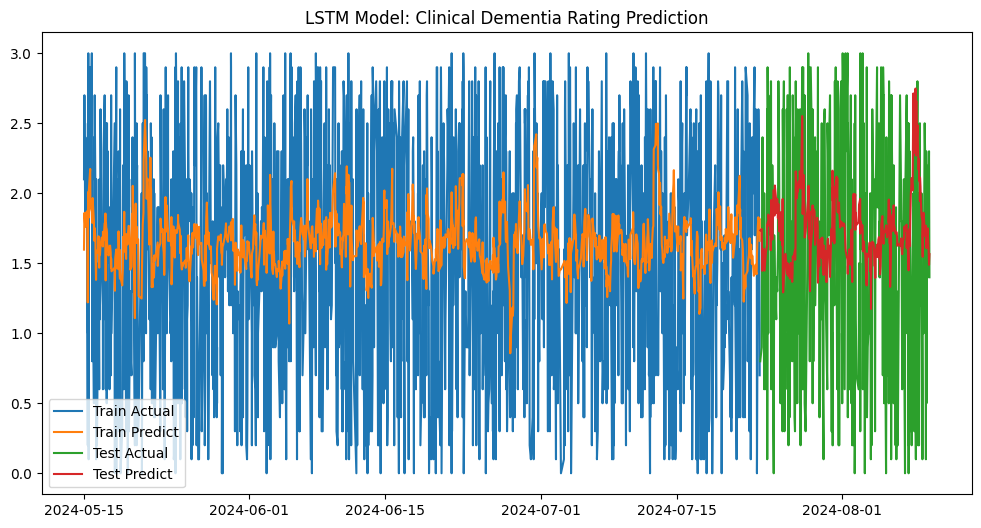

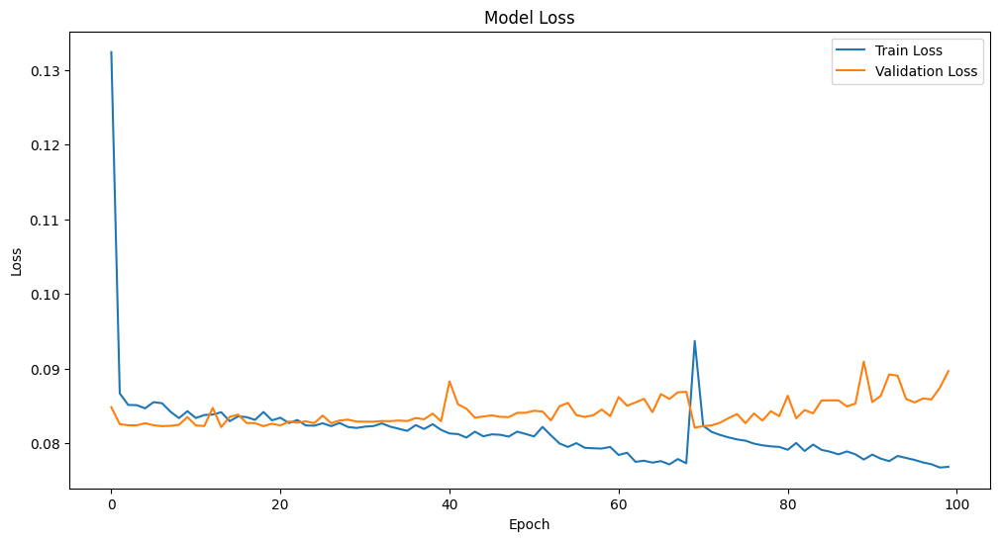


Building LSTM model for Patient 3


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
Train RMSE: 0.864
Test RMSE: 0.892
Train R2 Score: 0.021
Test R2 Score: -0.066


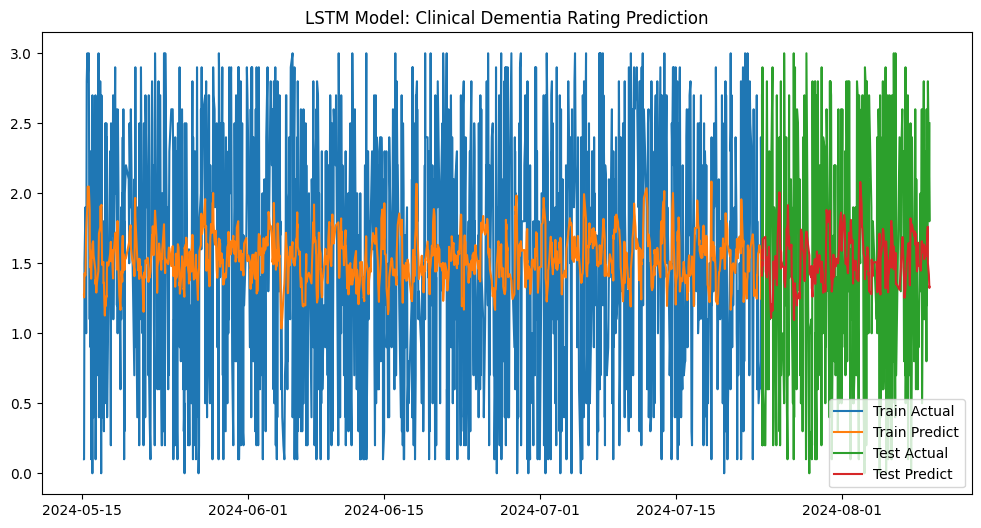

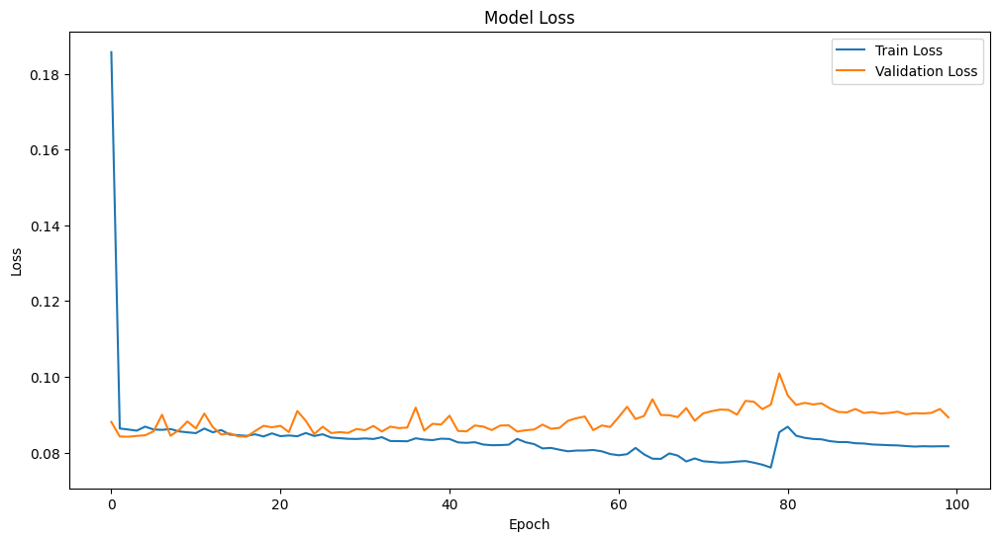


Building LSTM model for Patient 4


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Train RMSE: 0.822
Test RMSE: 0.942
Train R2 Score: 0.118
Test R2 Score: -0.192


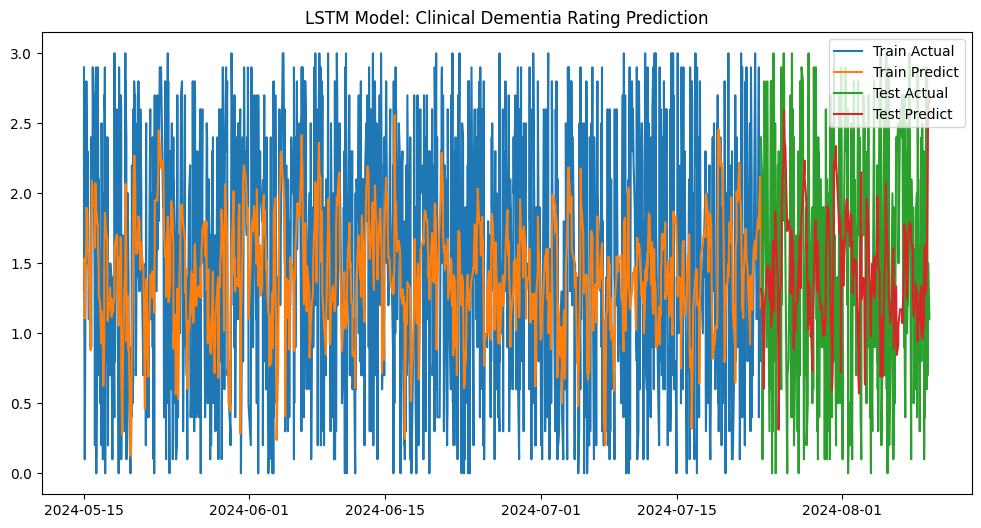

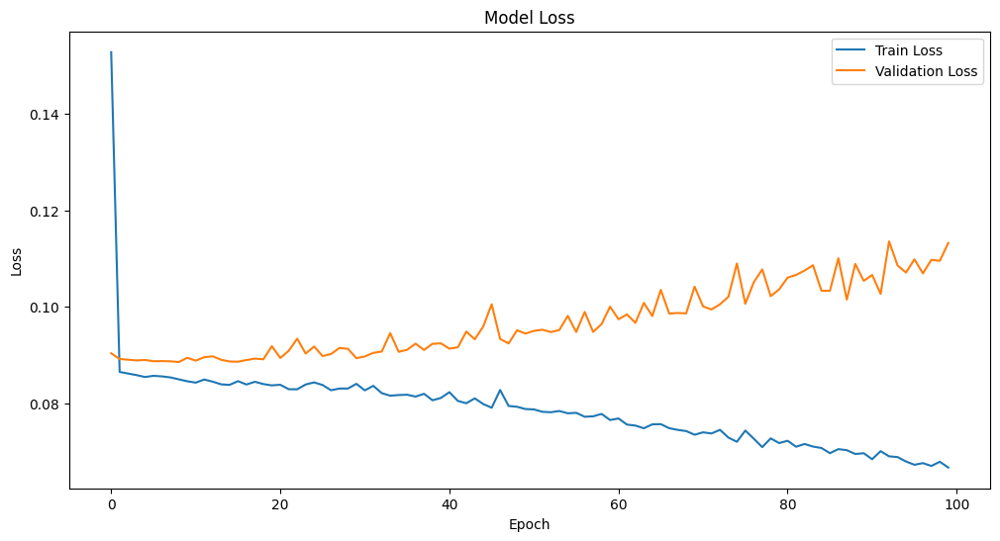


Building LSTM model for Patient 5


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
Train RMSE: 0.816
Test RMSE: 0.912
Train R2 Score: 0.135
Test R2 Score: -0.037


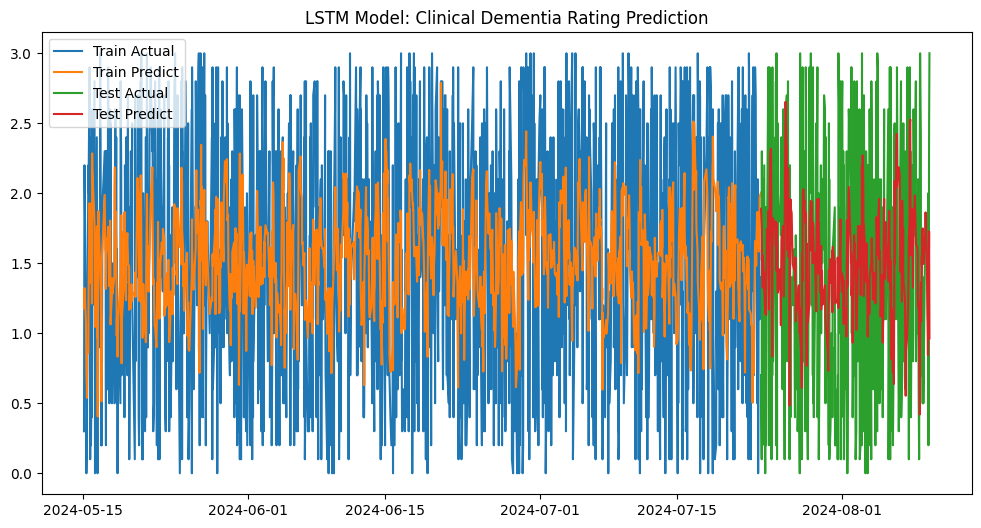

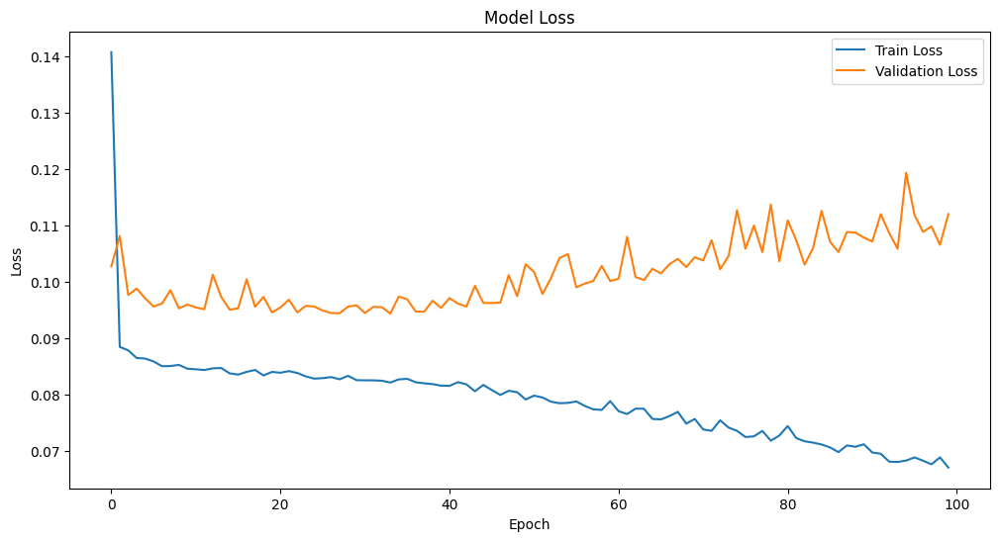


Building LSTM model for Patient 6


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Train RMSE: 0.800
Test RMSE: 0.873
Train R2 Score: 0.157
Test R2 Score: -0.128


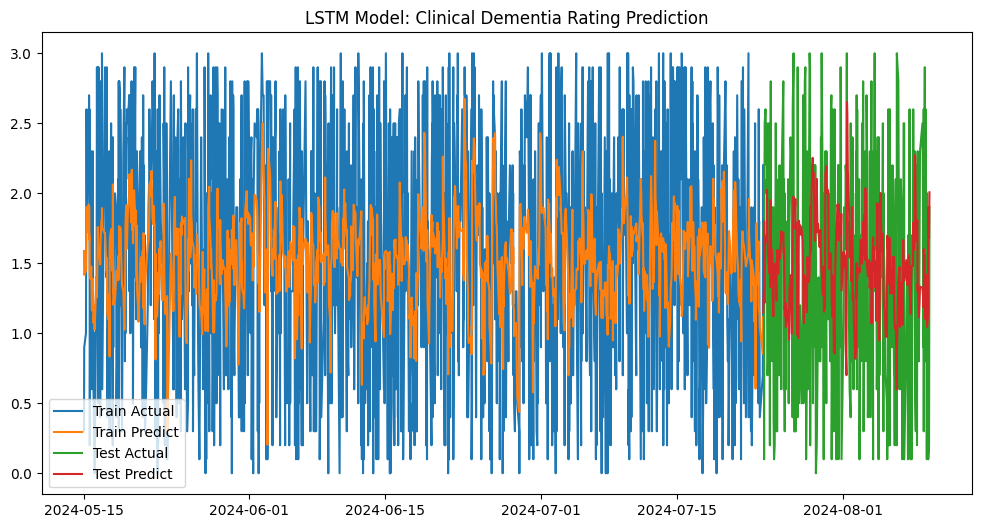

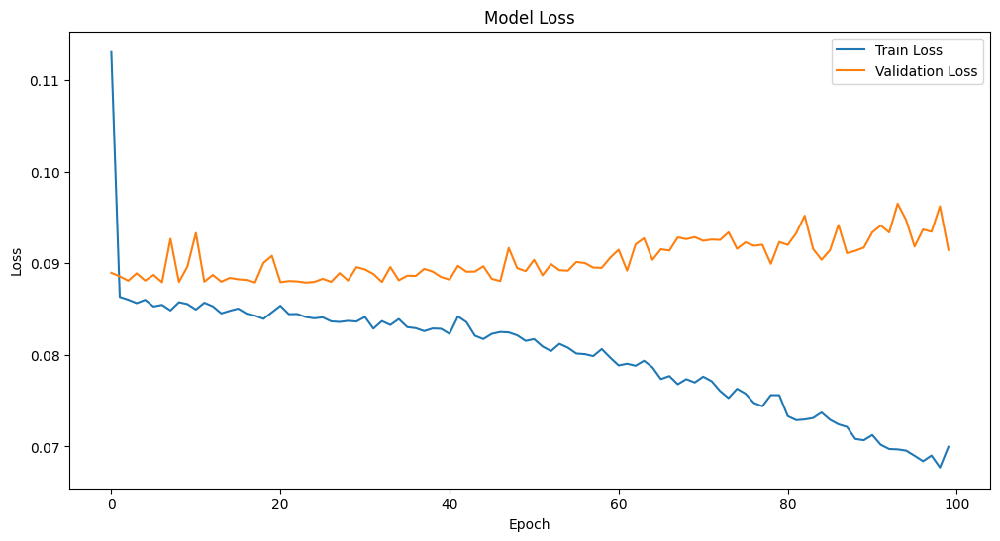


Building LSTM model for Patient 7


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Train RMSE: 0.820
Test RMSE: 0.960
Train R2 Score: 0.112
Test R2 Score: -0.209


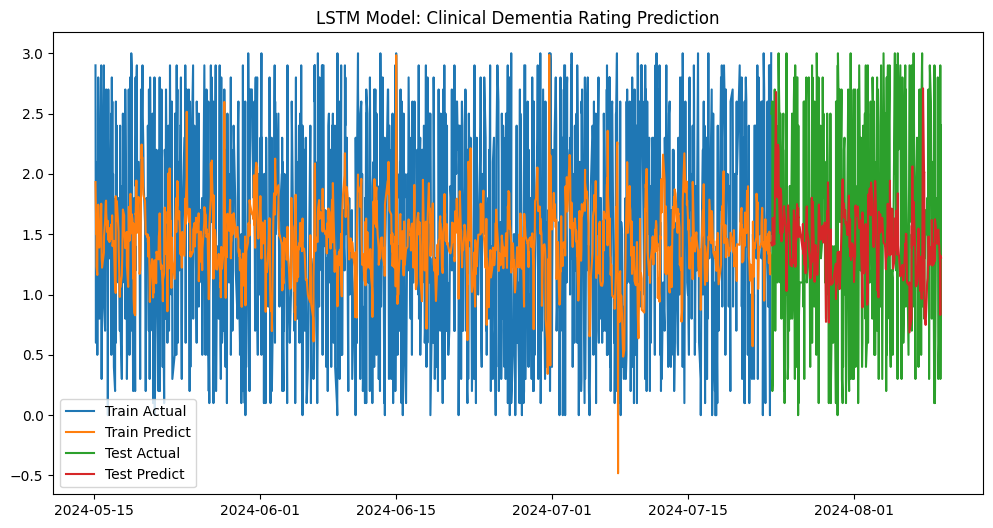

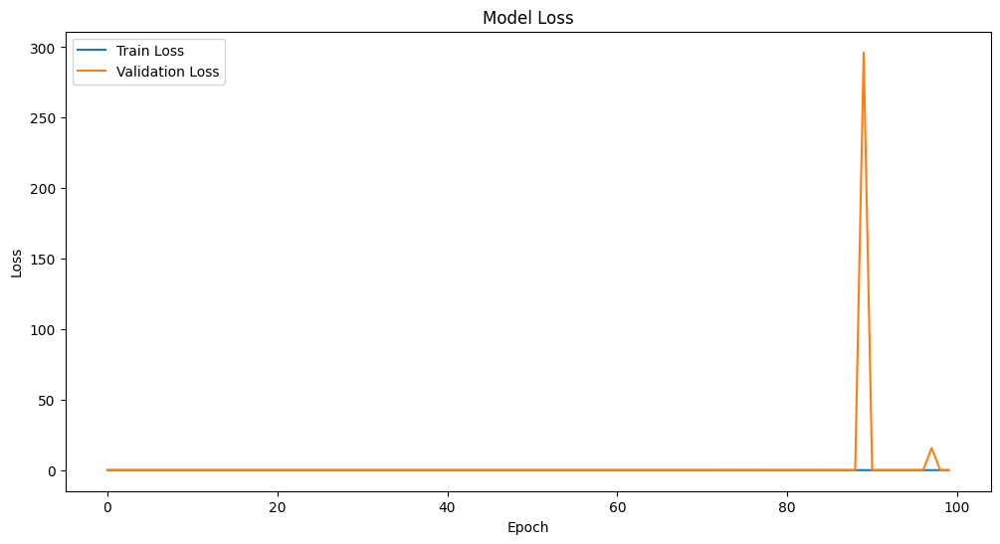


Building LSTM model for Patient 8


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
Train RMSE: 0.782
Test RMSE: 0.911
Train R2 Score: 0.187
Test R2 Score: -0.184


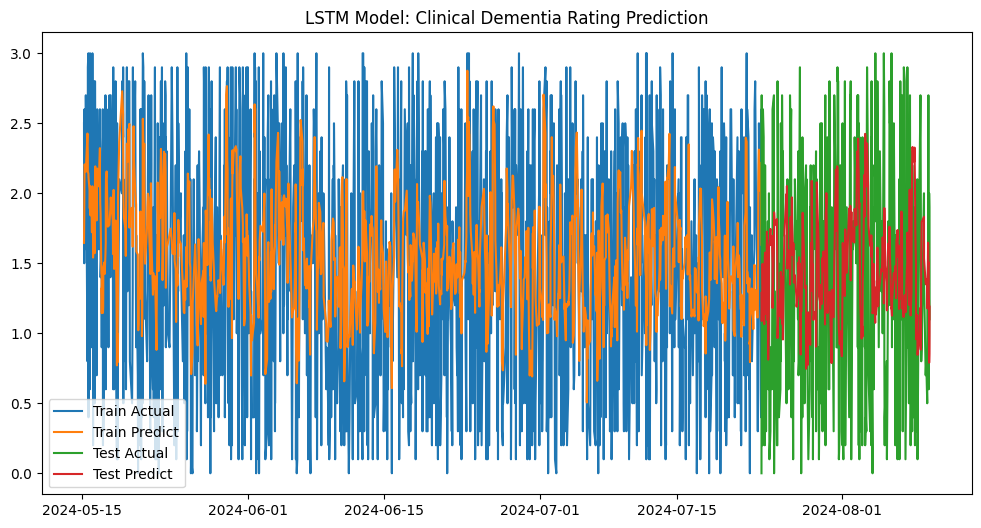

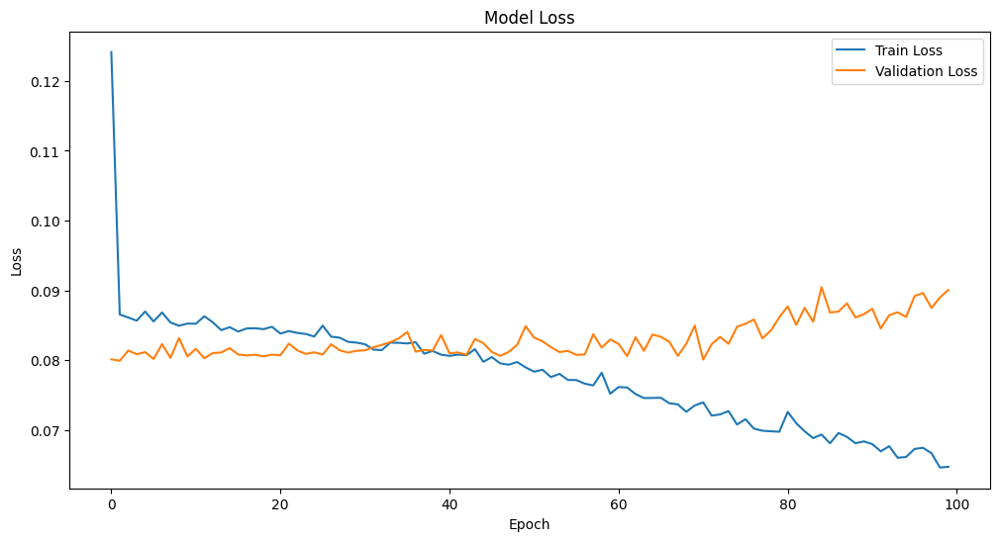


Building LSTM model for Patient 9


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Train RMSE: 0.809
Test RMSE: 0.962
Train R2 Score: 0.120
Test R2 Score: -0.187


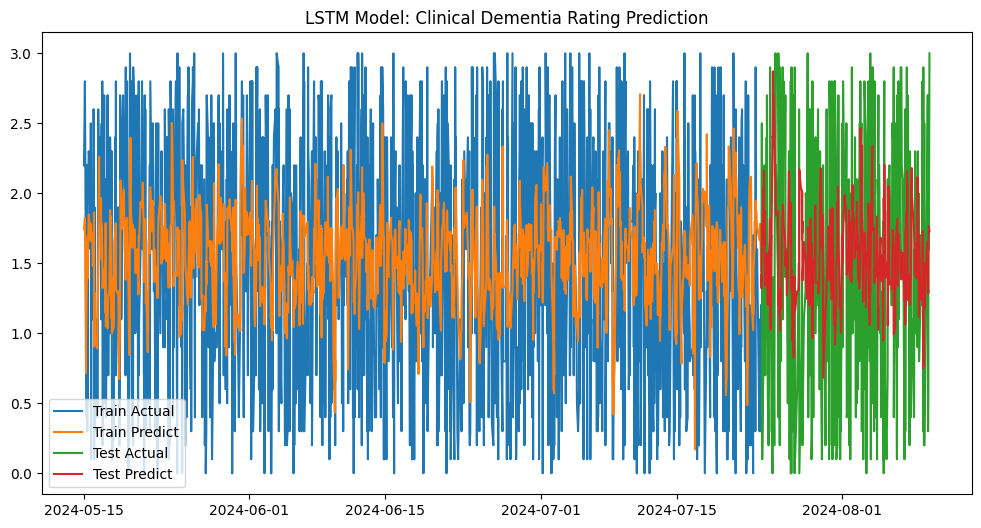

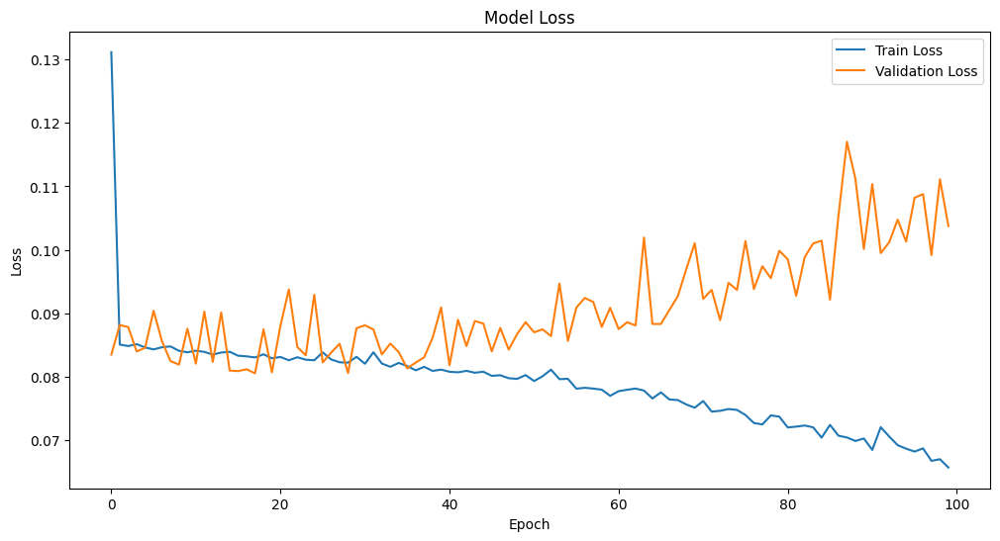


Building LSTM model for Patient 10


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
Train RMSE: 0.845
Test RMSE: 0.907
Train R2 Score: 0.036
Test R2 Score: -0.081


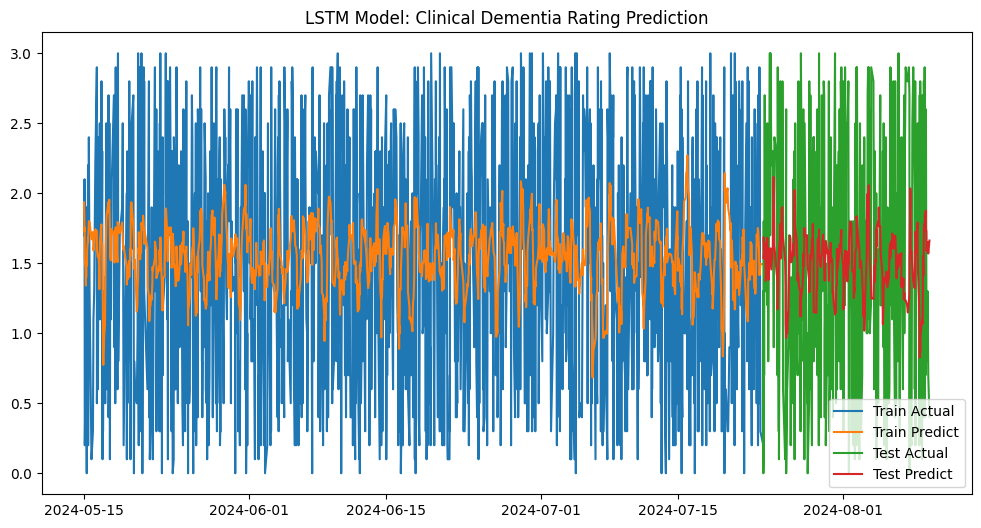

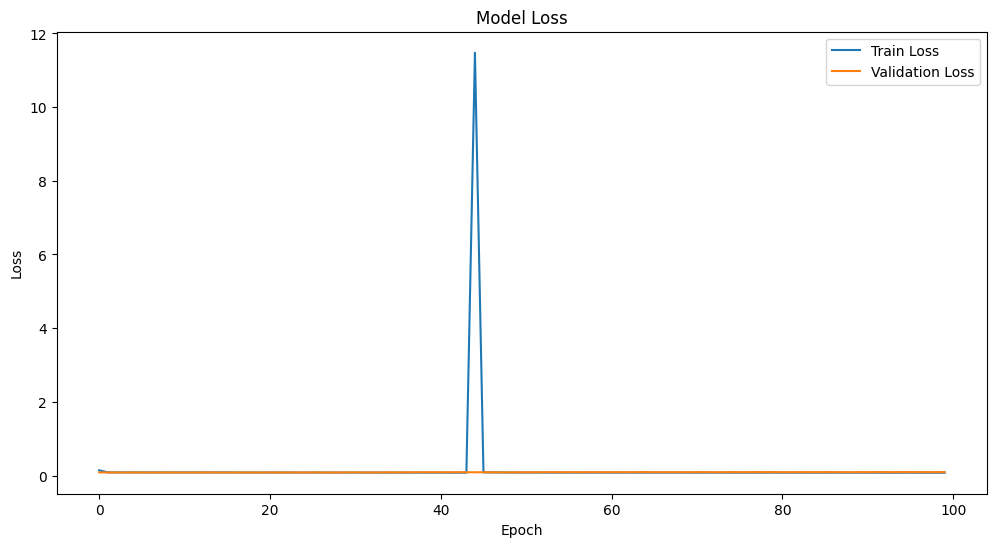

In [ ]:
# Build LSTM models for each patient
lstm_models = {}
for patient in df_minute['Patient ID'].unique():
    print(f"\nBuilding LSTM model for Patient {patient}")
    patient_data = df_minute[df_minute['Patient ID'] == patient].set_index('Timestamp')
    model, train_rmse, test_rmse, train_r2, test_r2 = build_lstm_model(patient_data)
    lstm_models[patient] = {
        'model': model,
        'train_rmse': train_rmse,
        'test_rmse': test_rmse,
        'train_r2': train_r2,
        'test_r2': test_r2
    }

In [ ]:
# Print summary of all models
for patient, model_info in lstm_models.items():
    print(f"\nPatient {patient}:")
    print(f"Train RMSE: {model_info['train_rmse']:.3f}")
    print(f"Test RMSE: {model_info['test_rmse']:.3f}")
    print(f"Train R2 Score: {model_info['train_r2']:.3f}")
    print(f"Test R2 Score: {model_info['test_r2']:.3f}")


Patient 1:
Train RMSE: 0.874
Test RMSE: 0.905
Train R2 Score: -0.058
Test R2 Score: -0.056

Patient 2:
Train RMSE: 0.848
Test RMSE: 0.961
Train R2 Score: 0.031
Test R2 Score: -0.174

Patient 3:
Train RMSE: 0.864
Test RMSE: 0.892
Train R2 Score: 0.021
Test R2 Score: -0.066

Patient 4:
Train RMSE: 0.822
Test RMSE: 0.942
Train R2 Score: 0.118
Test R2 Score: -0.192

Patient 5:
Train RMSE: 0.816
Test RMSE: 0.912
Train R2 Score: 0.135
Test R2 Score: -0.037

Patient 6:
Train RMSE: 0.800
Test RMSE: 0.873
Train R2 Score: 0.157
Test R2 Score: -0.128

Patient 7:
Train RMSE: 0.820
Test RMSE: 0.960
Train R2 Score: 0.112
Test R2 Score: -0.209

Patient 8:
Train RMSE: 0.782
Test RMSE: 0.911
Train R2 Score: 0.187
Test R2 Score: -0.184

Patient 9:
Train RMSE: 0.809
Test RMSE: 0.962
Train R2 Score: 0.120
Test R2 Score: -0.187

Patient 10:
Train RMSE: 0.845
Test RMSE: 0.907
Train R2 Score: 0.036
Test R2 Score: -0.081


# **Prophet Model:**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from prophet import Prophet
from prophet.plot import plot_plotly, plot_components_plotly
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from tqdm import tqdm

In [ ]:
target = 'Clinical Dementia Rating'
exog_vars = ['SPO2', 'Blood Pressure Systolic', 'Blood Pressure Diastolic', 'Temperature', 'Heart Rate']

In [ ]:
# Function to prepare data for Prophet
def prepare_prophet_data(data, target, exog_vars):
    df = data.copy()
    df = df.rename(columns={'Timestamp': 'ds', target: 'y'})
    return df[['ds', 'y'] + exog_vars]

# Function to evaluate Prophet model
def evaluate_prophet(train, test, exog_vars):
    model = Prophet(interval_width=0.95)
    for var in exog_vars:
        model.add_regressor(var)

    model.fit(train)

    future = test[['ds'] + exog_vars]
    forecast = model.predict(future)

    y_true = test['y'].values
    y_pred = forecast['yhat'].values

    mse = mean_squared_error(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)

    return model, mse, mae, rmse, r2

In [ ]:
# Prepare data and evaluate model for each patient
results = {}
for patient_id, group in tqdm(df_minute.groupby('Patient ID')):
    data = prepare_prophet_data(group, target, exog_vars)

    # Split data into train and test sets
    train_size = int(len(data) * 0.8)
    train, test = data[:train_size], data[train_size:]

    model, mse, mae, rmse, r2 = evaluate_prophet(train, test, exog_vars)

    results[patient_id] = {
        'model': model,
        'mse': mse,
        'mae': mae,
        'rmse': rmse,
        'r2': r2
    }

  0%|          | 0/10 [00:00<?, ?it/s]INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpnhkk5bzw/jkq6obdg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpnhkk5bzw/62i02rbc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57054', 'data', 'file=/tmp/tmpnhkk5bzw/jkq6obdg.json', 'init=/tmp/tmpnhkk5bzw/62i02rbc.json', 'output', 'file=/tmp/tmpnhkk5bzw/prophet_modelb0huftv0/prophet_model-20240827053634.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
05:36:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
05:36:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
 10%|█         | 1/10 [00:01<00:11,  1.27s/it]INFO:prophet:Disabling yearly seasonality. Run prophet w

In [ ]:
# Print average metrics across all patients
avg_mse = np.mean([res['mse'] for res in results.values()])
avg_mae = np.mean([res['mae'] for res in results.values()])
avg_rmse = np.mean([res['rmse'] for res in results.values()])
avg_r2 = np.mean([res['r2'] for res in results.values()])

print(f'Average Model Performance:')
print(f'MSE: {avg_mse:.4f}')
print(f'MAE: {avg_mae:.4f}')
print(f'RMSE: {avg_rmse:.4f}')
print(f'R-squared: {avg_r2:.4f}')

Average Model Performance:
MSE: 0.7662
MAE: 0.7523
RMSE: 0.8750
R-squared: -0.0210


In [ ]:
# Plot results for a single patient (you can change the patient_id as needed)
patient_id = list(results.keys())[0]
model = results[patient_id]['model']
data = prepare_prophet_data(df_minute[df_minute['Patient ID'] == patient_id], target, exog_vars)

In [ ]:
# Forecast for next 100 minutes
future = model.make_future_dataframe(periods=14400, freq='min')
for var in exog_vars:
    future[var] = data[var].iloc[-1]  # Use last known values for exogenous variables

In [ ]:
forecast = model.predict(future)

In [ ]:
fig1 = plot_plotly(model, forecast)
fig1.update_layout(title=f'Forecast for Patient {patient_id}',
                   xaxis_title='Date and Time',
                   yaxis_title='Clinical Dementia Rating')
fig1.show()

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [ ]:
fig2 = plot_components_plotly(model, forecast)
fig2.update_layout(title=f'Forecast Components for Patient {patient_id}')
fig2.show()

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

